In [1]:
from typing import List

import matplotlib.pyplot as plt
from torchvision import io, transforms
from torchvision.utils import Image, ImageDraw
from torchvision.transforms.functional import to_pil_image
import numpy as np

%matplotlib inline

Matplotlib created a temporary config/cache directory at /tmp/pbs.3958452.pbsha.ib.sockeye/matplotlib-d0uaj408 because the default path (/home/jovyan/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


## import sample image

In [2]:
img = Image.open('/scratch/st-singha53-1/datasets/geomx/dkd/geomx_pngs/disease1B_scan/disease1B_scan - 001.png').convert('RGB')
transform = transforms.Compose([
 transforms.ToTensor()
])
img = transform(img)
img.shape

torch.Size([3, 2508, 1906])

#### Channels:	
 - FITC/525 nm : SYTO 13 : DNA (Grey)
 - Cy3/568 nm : Alexa 532 : PanCK (Yellow)
 - Texas Red/615 nm : Alexa 594 : CD45 (Cyan)
 - Cy5/666 nm : Cy5 : Custom (Magenta)

**SYTO** Deep Red Nucleic Acid Stain is cell-permeant dye that specifically stains the nuclei of live, dead, or fixed cells.

**pan-CK** (AE1/AE3) and EMA are epithelium-specific antibodies. As the basic component of cellular structure of normal epithelial cells and epithelial cancer cells, they are often used to differentiate tumors according to whether they originate from the epithelium or not.

**CD45** is a signalling molecule that is an essential regulator of T and B cell antigen receptor signalling.

**CD10+CD31** – Proximal nephrons and endothelial cells (Custom)

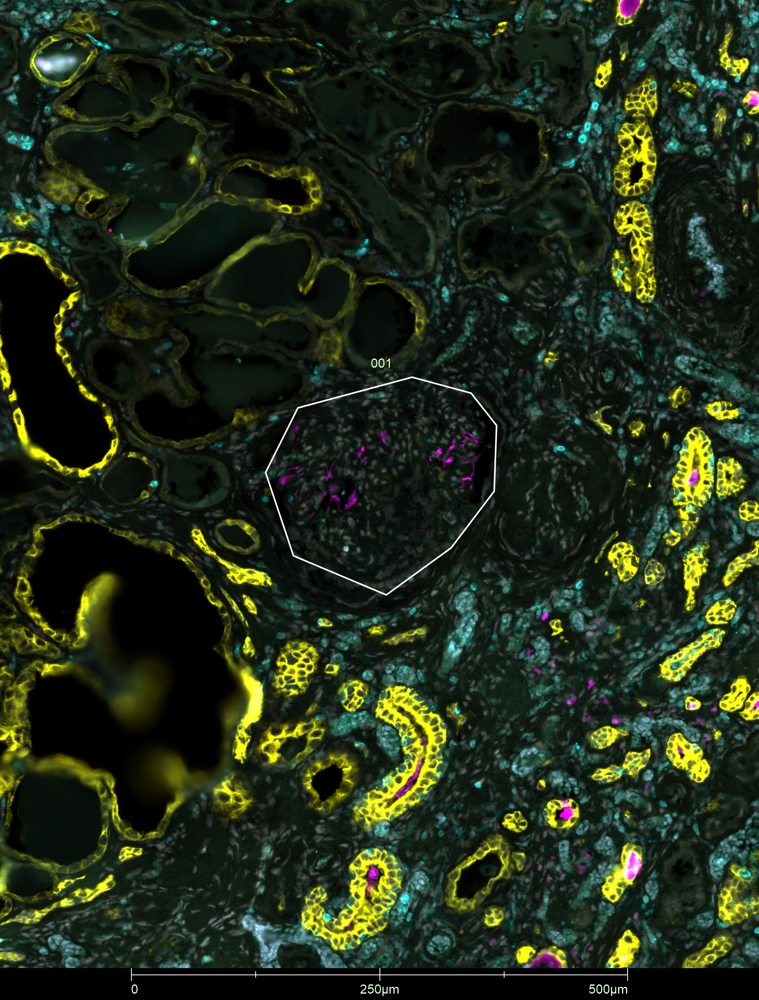

In [3]:
to_pil_image(img)

In [4]:
img = Image.open('/scratch/st-singha53-1/datasets/geomx/dkd/geomx_pngs/disease1B_scan/disease1B_scan - 001.png').convert('RGB')
transform = transforms.Compose([
 transforms.ToTensor()
])
img = transform(img)
img.shape

torch.Size([3, 2508, 1906])

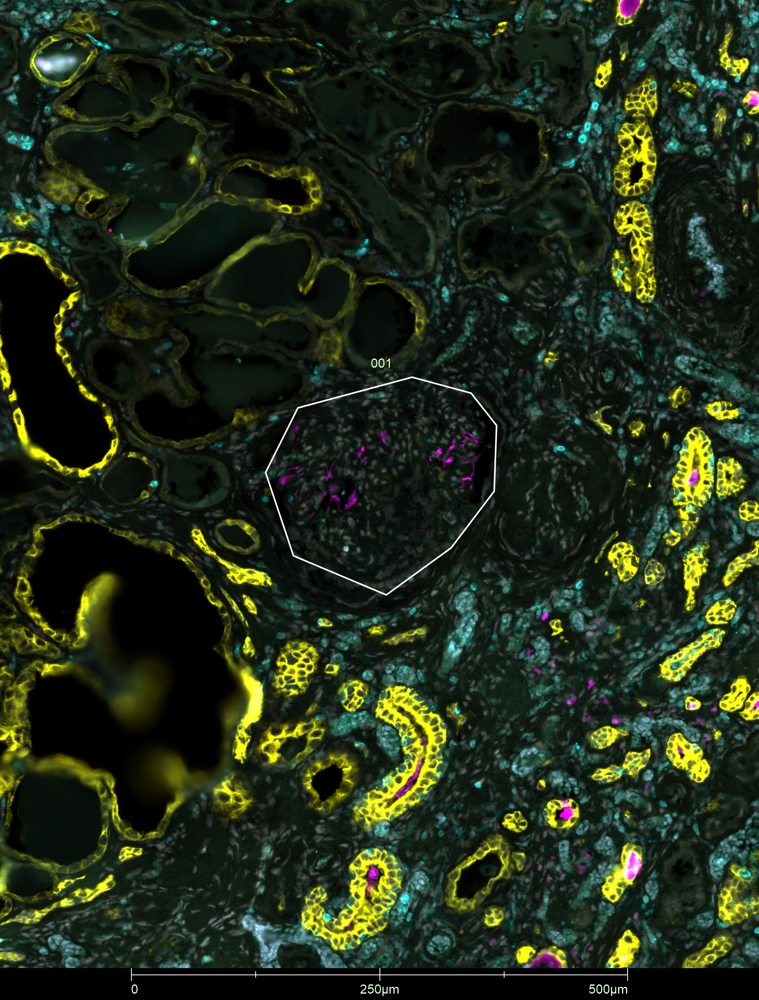

In [5]:
to_pil_image(img)

## image resize

In [6]:
f = 3
IMG_SIZE = 256*f
PATCH_SIZE = 256

resize = transforms.Resize((IMG_SIZE, IMG_SIZE))
resized_img = resize(img)
resized_img.shape

torch.Size([3, 768, 768])

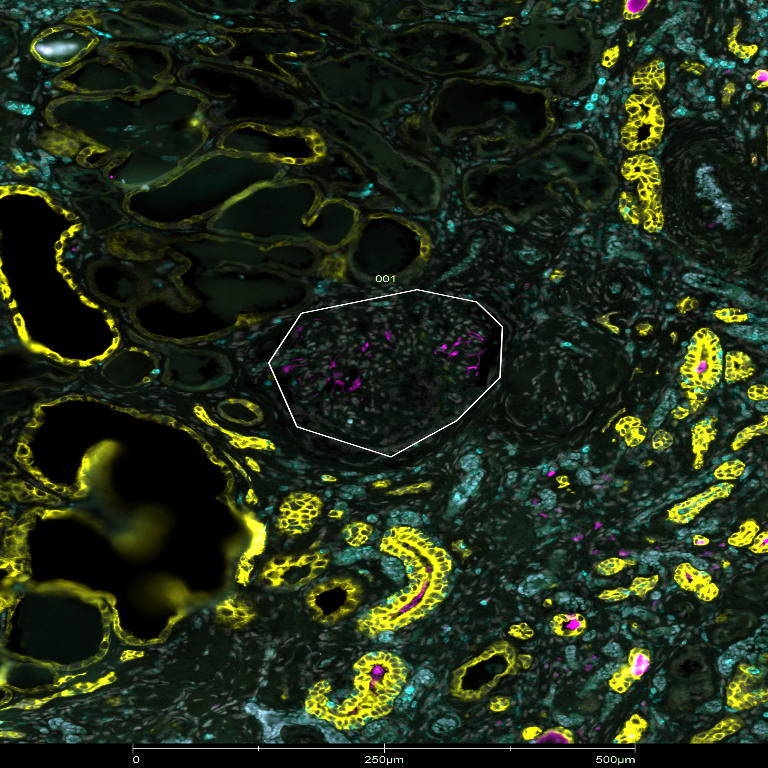

In [7]:
to_pil_image(resized_img)

## Patches

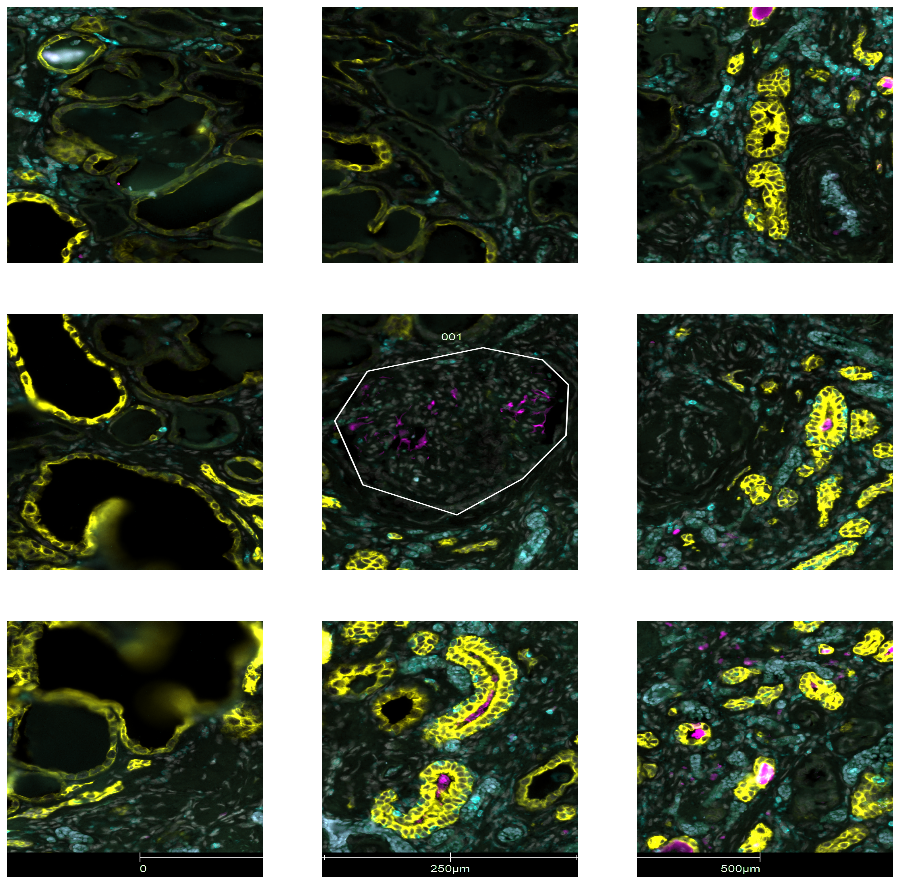

In [8]:
patches = resized_img.unfold(1, PATCH_SIZE, PATCH_SIZE).unfold(2, PATCH_SIZE, PATCH_SIZE)

dataset = []

fig, ax = plt.subplots(f, f, figsize=(16, 16))
for i in range(f):
    for j in range(f):
        sub_img = patches[:, i, j]
        dataset.append(sub_img.unsqueeze(0))
        ax[i][j].imshow(to_pil_image(sub_img))
        ax[i][j].axis('off')

In [9]:
import os

os.getcwd()
!ls -lahtr

total 705M
-rw-rw----  1 singha53 nogroup  234M Jan  6  2017 alexnet-owt-4df8aa71.pth
drwxrws---  3 singha53 nogroup  4.0K Jul 11 01:08 ..
drwxrws---  3 singha53 nogroup  4.0K Jul 11 01:13 .local
drwxrwsr-x  3 singha53 nogroup  4.0K Jul 11 01:27 .conda
drwxrws---  2 singha53 nogroup  4.0K Jul 11 01:50 .jupyter
drwxr-xr-x  2 singha53 nogroup  4.0K Jul 11 14:58 geomx_data
-rw-rw----  1 singha53 nogroup  3.4K Jul 11 16:25 Untitled1.ipynb
drwxrws---  5 singha53 nogroup  4.0K Jul 11 16:50 .ipython
-rw-rw----  1 singha53 nogroup  1.6K Jul 11 16:52 Untitled2.ipynb
drwxr-xr-x  2 singha53 nogroup  4.0K Jul 11 21:45 .fontconfig
drwxrws---  3 singha53 nogroup  4.0K Jul 11 21:45 .config
drwx--S---  3 singha53 nogroup  4.0K Jul 13 17:06 .nv
-rw-rw----  1 singha53 nogroup   431 Jul 13 17:16 .bashrc
-rw-------  1 singha53 nogroup  2.7K Jul 13 23:54 .bash_history
-rw-rw----  1 singha53 nogroup   923 Jul 19 17:14 Untitled.ipynb
drwxrws---  7 singha53 nogroup  4.0K Jul 21 11:32 geomx2rna
-rw-rw----  1 s

In [10]:
import os

os.getcwd()

'/scratch/st-singha53-1/singha53/geomx2rna/amrit/my_jupyter'

In [11]:
import torch
import torchvision
from torchvision import models
from torchvision import transforms

torch.manual_seed(0)
np.random.seed(0)

model = models.alexnet()
model.load_state_dict(torch.load('alexnet-owt-4df8aa71.pth'))
model.eval()

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [12]:
import torch
import torch.nn.functional as F

from PIL import Image

import os
import json
import numpy as npd
from matplotlib.colors import LinearSegmentedColormap

import torchvision
from torchvision import models
from torchvision import transforms

from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Saliency
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz


In [13]:
# !wget -P / https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json
labels_path = 'imagenet_class_index.json'
with open(labels_path) as json_data:
    idx_to_labels = json.load(json_data)

In [14]:
input = dataset[0]

output = model(input)
output = F.softmax(output, dim=1)
prediction_score, pred_label_idx = torch.topk(output, 1)

pred_label_idx.squeeze_()
predicted_label = idx_to_labels[str(pred_label_idx.item())][1]
print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

Predicted: water_snake ( 0.23381632566452026 )


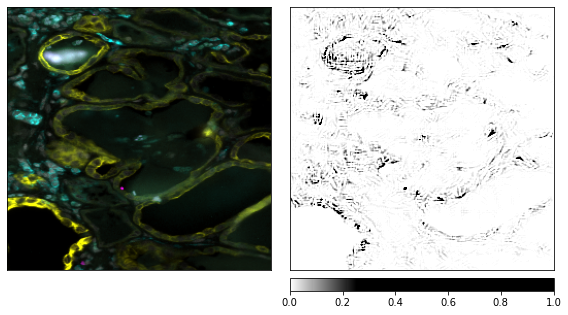

In [15]:
# Create IntegratedGradients object and get attributes
integrated_gradients = IntegratedGradients(model)
attributions_ig = integrated_gradients.attribute(input, target=pred_label_idx, n_steps=200)

# create custom colormap for visualizing the result
default_cmap = LinearSegmentedColormap.from_list('custom blue', 
                                                 [(0, '#ffffff'),
                                                  (0.25, '#000000'),
                                                  (1, '#000000')], N=256)


# visualize the results using the visualize_image_attr helper method
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_ig.squeeze().cpu().detach().numpy(), (1,2,0)),
                             np.transpose(input.squeeze().cpu().detach().numpy(), (1,2,0)),
                             methods=["original_image", "heat_map"],
                             signs=['all', 'positive'],
                             cmap=default_cmap,
                             show_colorbar=True)

## train ResNet with trian and validation set of images

In [16]:
def create_datasets(dict_images, n_patches = 9, ref_group = 'normal'):
    PATCH_SIZE = 256
    f = int(np.sqrt(n_patches))
    IMG_SIZE = PATCH_SIZE * f
    resize = transforms.Resize((IMG_SIZE, IMG_SIZE))
    transform = transforms.Compose([
     transforms.ToTensor()
    ])
    
    images = {}
    for group in dict_images.keys():
        dataset = []
        for img in dict_images[group]:
            ## import image
            img = Image.open('geomx_data/'+img+'.png').convert('RGB')
            ## convert img to tensor
            img = transform(img)
            ## resize image
            resized_img = resize(img)
            ## create patches
            patches = resized_img.unfold(1, PATCH_SIZE, PATCH_SIZE).unfold(2, PATCH_SIZE, PATCH_SIZE)
            ## reshape data
            for i in range(f):
                for j in range(f):
                    sub_img = patches[:, i, j]
                    if group == ref_group:
                        data_target = (sub_img, 0)
                    else:
                        data_target = (sub_img, 1)
                    dataset.append(data_target)
            images[group] = dataset
    return images

class Custom_Dataset(torch.utils.data.dataset.Dataset):
    def __init__(self, _dataset):
        self.dataset = _dataset

    def __getitem__(self, index):
        example, target = self.dataset[index]
        return example, target

    def __len__(self):
        return len(self.dataset)

In [17]:
from os import listdir
from os.path import isfile, join

path_to_images = "/scratch/st-singha53-1/datasets/geomx/dkd/geomx_pngs/disease1B_scan/"
onlyfiles = [f for f in listdir(path_to_images) if isfile(join(path_to_images, f))]

onlyfiles

['disease1B_scan - 002.png',
 'disease1B_scan - 023.png',
 'disease1B_scan - 024.png',
 'disease1B_scan - 021.png',
 'disease1B_scan - 006.png',
 'disease1B_scan - 005.png',
 'disease1B_scan - 004.png',
 'disease1B_scan - 019.png',
 'disease1B_scan - 016.png',
 'disease1B_scan - 012.png',
 'disease1B_scan - 022.png',
 'disease1B_scan - 020.png',
 'disease1B_scan - 001.png',
 'disease1B_scan - 003.png',
 'disease1B_scan - 007.png',
 'disease1B_scan - 010.png',
 'disease1B_scan - 015.png',
 'disease1B_scan - 014.png',
 'disease1B_scan - 017.png',
 'disease1B_scan - 009.png',
 'disease1B_scan - 013.png',
 'disease1B_scan - 008.png',
 'disease1B_scan - 018.png',
 'disease1B_scan - 011.png']

In [18]:
def process_image(path_to_images, x, group, ref_group):
    ## import image
    img = Image.open(path_to_images+x).convert('RGB')
    ## convert img to tensor
    img = transform(img)
    ## resize image
    resized_img = resize(img)
    ## create patches
    patches = resized_img.unfold(1, PATCH_SIZE, PATCH_SIZE).unfold(2, PATCH_SIZE, PATCH_SIZE)
    dataset=[]
    ## reshape data
    for i in range(f):
        for j in range(f):
            sub_img = patches[:, i, j]
            if group == ref_group:
                data_target = (sub_img, 0)
            else:
                data_target = (sub_img, 1)
            dataset.append(data_target)
    return dataset

In [19]:
def create_datasets(dict_images={}, n_patches = 9, ref_group = 'normal', path_to_images=[]):
    PATCH_SIZE = 256
    f = int(np.sqrt(n_patches))
    IMG_SIZE = PATCH_SIZE * f
    resize = transforms.Resize((IMG_SIZE, IMG_SIZE))
    transform = transforms.Compose([
     transforms.ToTensor()
    ])
    
    images = {}
    for group in dict_images.keys():
        for sample in dict_images[group]:
            path = path_to_images+sample+"/"
            onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]
            l = [process_image(path, x, group, ref_group) for x in onlyfiles]
            flat_list = [item for sublist in l for item in sublist]
            images[group] = flat_list
    return images

class Custom_Dataset(torch.utils.data.dataset.Dataset):
    def __init__(self, _dataset):
        self.dataset = _dataset

    def __getitem__(self, index):
        example, target = self.dataset[index]
        return example, target

    def __len__(self):
        return len(self.dataset)

In [20]:
train = {'dkd': ['disease1B_scan', 'disease2B_scan'],
         'normal': ['normal2B_scan']}
valid = {'dkd': ['disease3_scan'],
         'normal': ['normal3_scan']}
test = {'dkd': ['disease4_scan'],
        'normal': ['normal4_scan']}

In [42]:
path_to_images = "/scratch/st-singha53-1/datasets/geomx/dkd/geomx_pngs/"

print("train loader")
train_datasets = create_datasets(dict_images = train, n_patches = 100, ref_group = 'normal', path_to_images=path_to_images)
train_loader = torch.utils.data.DataLoader(dataset=Custom_Dataset(train_datasets['dkd'] + train_datasets['normal']),
                                   batch_size=1,
                                   shuffle=False)

print("validation loader")
valid_datasets = create_datasets(dict_images = valid, n_patches = 100, ref_group = 'normal', path_to_images=path_to_images)
valid_loader = torch.utils.data.DataLoader(dataset=Custom_Dataset(valid_datasets['dkd'] + valid_datasets['normal']),
                                   batch_size=1,
                                   shuffle=False)

print("test loader")
test_datasets = create_datasets(dict_images = test, n_patches = 100, ref_group = 'normal', path_to_images=path_to_images)
test_loader = torch.utils.data.DataLoader(dataset=Custom_Dataset(test_datasets['dkd'] + test_datasets['normal']),
                                   batch_size=1,
                                   shuffle=False)

train loader
validation loader
test loader


In [43]:
from torch import nn, optim

# Hyperparameters
in_channel = 3
num_classes = 2
learning_rate = 1e-3
num_epochs = 10

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Model
torch.manual_seed(0)
np.random.seed(0)

net = models.alexnet()
net.load_state_dict(torch.load('alexnet-owt-4df8aa71.pth'))
net

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [44]:
net.classifier[6] = nn.Linear(4096, 2)
net

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [45]:
for param in net.parameters():
    param.requires_grad = False
net.classifier[6].weight.requires_grad = True
net.classifier[6].bias.requires_grad = True
net.eval()
net.to(device)

# Loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(net.parameters(), lr=learning_rate)
net

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

In [47]:
for param in net.parameters():
    print(param.requires_grad)

False
False
False
False
False
False
False
False
False
False
False
False
False
False
True
True


In [50]:
def accuracy(out, labels):
    _,pred = torch.max(out, dim=1)
    return torch.sum(pred==labels).item()

n_epochs = 150
print_every = 10
valid_loss_min = np.Inf
val_loss = []
val_acc = []
train_loss = []
train_acc = []
total_step = len(train_loader)
for epoch in range(1, n_epochs+1):
    running_loss = 0.0
    correct = 0
    total=0
    print(f'Epoch {epoch}\n')
    for batch_idx, (data_, target_) in enumerate(train_loader):
        data_, target_ = data_.to(device), target_.to(device)
        optimizer.zero_grad()
        
        outputs = net(data_)
        loss = criterion(outputs, target_)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _,pred = torch.max(outputs, dim=1)
        correct += torch.sum(pred==target_).item()
        total += target_.size(0)
        if (batch_idx) % 20 == 0:
            print ('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}' 
                   .format(epoch, n_epochs, batch_idx, total_step, loss.item()))
    train_acc.append(100 * correct / total)
    train_loss.append(running_loss/total_step)
    print(f'\ntrain-loss: {np.mean(train_loss):.4f}, train-acc: {(100 * correct/total):.4f}')
    batch_loss = 0
    total_t=0
    correct_t=0
    with torch.no_grad():
        net.eval()
        for data_t, target_t in (valid_loader):
            data_t, target_t = data_t.to(device), target_t.to(device)
            outputs_t = net(data_t)
            loss_t = criterion(outputs_t, target_t)
            batch_loss += loss_t.item()
            _,pred_t = torch.max(outputs_t, dim=1)
            correct_t += torch.sum(pred_t==target_t).item()
            total_t += target_t.size(0)
        val_acc.append(100 * correct_t/total_t)
        val_loss.append(batch_loss/len(valid_loader))
        network_learned = batch_loss < valid_loss_min
        print(f'validation loss: {np.mean(val_loss):.4f}, validation acc: {(100 * correct_t/total_t):.4f}\n')

        
        if network_learned:
            valid_loss_min = batch_loss
            torch.save(net.state_dict(), 'model.pt')
            print('Improvement-Detected, save-model')
    net.train()

Epoch 1

Epoch [1/150], Step [0/405], Loss: 0.6083
Epoch [1/150], Step [20/405], Loss: 0.0001
Epoch [1/150], Step [40/405], Loss: 0.0000
Epoch [1/150], Step [60/405], Loss: 0.0000
Epoch [1/150], Step [80/405], Loss: 0.0000
Epoch [1/150], Step [100/405], Loss: 0.0000
Epoch [1/150], Step [120/405], Loss: 0.0000
Epoch [1/150], Step [140/405], Loss: 0.0000
Epoch [1/150], Step [160/405], Loss: 0.0000
Epoch [1/150], Step [180/405], Loss: 0.0000
Epoch [1/150], Step [200/405], Loss: 0.0000
Epoch [1/150], Step [220/405], Loss: 0.0000
Epoch [1/150], Step [240/405], Loss: 0.0000
Epoch [1/150], Step [260/405], Loss: 0.0000
Epoch [1/150], Step [280/405], Loss: 0.0000
Epoch [1/150], Step [300/405], Loss: 0.0000
Epoch [1/150], Step [320/405], Loss: 0.0000
Epoch [1/150], Step [340/405], Loss: 0.0000
Epoch [1/150], Step [360/405], Loss: 0.0000
Epoch [1/150], Step [380/405], Loss: 0.0000
Epoch [1/150], Step [400/405], Loss: 0.0000

train-loss: 0.1496, train-acc: 98.5185
validation loss: 12.3802, validat

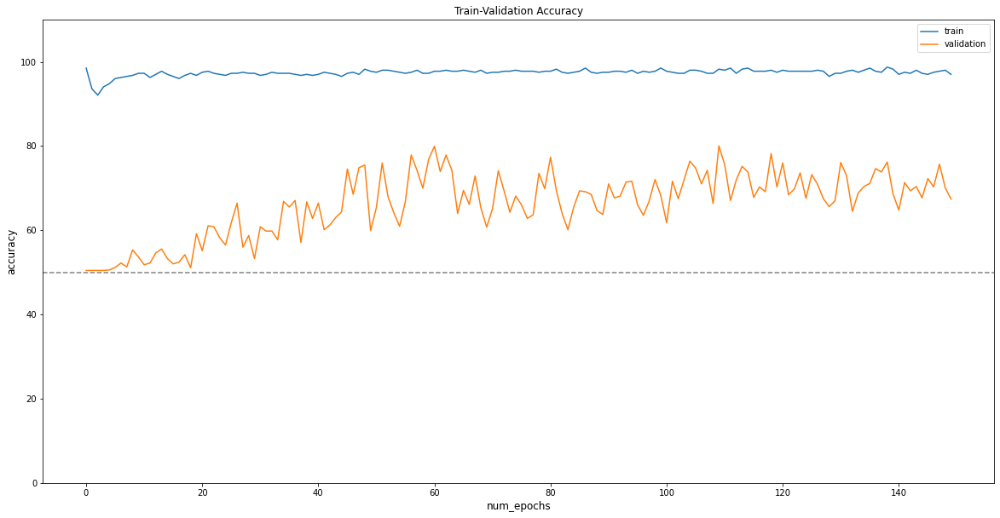

In [51]:
fig = plt.figure(figsize=(20,10))
plt.title("Train-Validation Accuracy")
plt.plot(train_acc, label='train')
plt.plot(val_acc, label='validation')
plt.xlabel('num_epochs', fontsize=12)
plt.ylabel('accuracy', fontsize=12)
plt.legend(loc='best')
plt.ylim(0,110)
plt.axhline(y=50, color='gray', linestyle='--')